In [2]:
import os
import numpy as np
import pickle
import random
import timeit

In [23]:


'''
Note:  This code is just a hint for people who are not familiar with text processing in python. There is no obligation to use this code, though you may if you like. 
'''


def folder_list(path,label):
    '''
    PARAMETER PATH IS THE PATH OF YOUR LOCAL FOLDER
    '''
    filelist = os.listdir(path)
    review = []
    for infile in filelist:
        file = os.path.join(path,infile)
        r = read_data(file)
        r.append(label)
        review.append(r)
    return review

def read_data(file):
    '''
    Read each file into a list of strings. 
    Example:
    ["it's", 'a', 'curious', 'thing', "i've", 'found', 'that', 'when', 'willis', 'is', 'not', 'called', 'on', 
    ...'to', 'carry', 'the', 'whole', 'movie', "he's", 'much', 'better', 'and', 'so', 'is', 'the', 'movie']
    '''
    f = open(file,encoding='UTF-8')
    lines = f.read().split(' ')
    symbols = '${}()[].,:;+-*/&|<>=~" '
    table = str.maketrans("a", "a", symbols)
    words = map(lambda Element: Element.translate(table).strip(), lines)
    words = filter(None, words)
    words = list(words)
    return words

###############################################
######## YOUR CODE STARTS FROM HERE. ##########
###############################################

def shuffle_data():
    '''
    pos_path is where you save positive review data.
    neg_path is where you save negative review data.
    '''
    pos_path = "/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/data/pos"
    neg_path = "/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/data/neg"
    
    pos_review = folder_list(pos_path,1)
    neg_review = folder_list(neg_path,-1)

    review = pos_review + neg_review
    random.seed(0)
    random.shuffle(review)
    pickle.dump(review, open("/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/data/allreview.p", "wb" ) )

'''
Now you have read all the files into list 'review' and it has been shuffled.
Save your shuffled result by pickle.
*Pickle is a useful module to serialize a python object structure. 
*Check it out. https://wiki.python.org/moin/UsingPickle
'''

"\nNow you have read all the files into list 'review' and it has been shuffled.\nSave your shuffled result by pickle.\n*Pickle is a useful module to serialize a python object structure. \n*Check it out. https://wiki.python.org/moin/UsingPickle\n"

In [24]:
shuffle_data()

In [3]:
reviews = pickle.load(open("/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/data/allreview.p", "rb" ) )
training_data = reviews[0:1500]
validation_data = reviews[1500:2000]
len(reviews)

2000

In [10]:
import nltk
nltk.download()

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


True

In [108]:
from collections import Counter
from nltk.corpus import stopwords
import nltk

def bag_of_words(words):
    '''
    words is a list of words
    -------------------
    count sparse bag of words representation.
    '''
    stop = set(stopwords.words('english'))
    words_stopfree = [w for w in words if w not in stop]
    count = Counter(words_stopfree[:-1])
    label = words[-1]
    return count, label

In [10]:
words=[('hello','world'),'Hello','world','it','is','a','new','start', 1]
words, l = bag_of_words(words)

In [11]:
words

Counter({'Hello': 1, 'new': 1, ('hello', 'world'): 1, 'world': 1, 'start': 1})

In [109]:
X_train  = []
y_train = []
for i in range(len(training_data)):
    words, label = bag_of_words(training_data[i])
    X_train.append(words)
    y_train.append(label)

In [134]:
training_data[1]

['capsule',
 'gal',
 'is',
 'a',
 '50sish',
 'london',
 'cockney',
 'gangster',
 'who',
 'has',
 'retired',
 'to',
 'spain',
 'his',
 'old',
 'associates',
 'want',
 'him',
 'for',
 'one',
 'last',
 'job',
 'and',
 'send',
 'the',
 'vicious',
 'don',
 'to',
 'give',
 'him',
 'an',
 'offer',
 'he',
 "can't",
 'refuse',
 'a',
 'standout',
 'performance',
 'by',
 'ben',
 'kingsley',
 'as',
 'don',
 'cannot',
 'save',
 'what',
 'is',
 'essentially',
 'a',
 'set',
 'of',
 'cliches',
 'recycled',
 'from',
 'old',
 'westerns',
 '0',
 '4',
 'to',
 '4',
 'roger',
 'ebert',
 'asks',
 'in',
 'his',
 'review',
 'of',
 'sexy',
 'beast',
 'who',
 'would',
 'have',
 'guessed',
 'that',
 'the',
 'most',
 'savage',
 'maddog',
 'frothing',
 'gangster',
 'in',
 'recent',
 'movies',
 'would',
 'be',
 'played',
 'by',
 'ben',
 'kingsley',
 '?',
 'my',
 'response',
 'would',
 'be',
 'that',
 'anyone',
 'who',
 'has',
 'seen',
 'alan',
 'arkin',
 'in',
 'wait',
 'until',
 'dark',
 'henry',
 'fonda',
 'in',
 

In [110]:
X_valid  = []
y_valid = []
for i in range(len(validation_data)):
    words, label = bag_of_words(validation_data[i])
    X_valid.append(words)
    y_valid.append(label)

In [30]:
print(X_train[10])

Counter({'the': 31, 'to': 16, 'and': 16, 'a': 15, 'of': 15, 'in': 6, 'as': 6, 'from': 6, 'with': 6, 'is': 5, 'are': 5, 'we': 4, 'most': 4, 'have': 4, 'ghosts': 4, 'hand': 4, 'mars': 4, 'convenient': 4, 'even': 3, 'cube': 3, 'one': 3, 'for': 3, 'all': 3, 'has': 3, 'this': 3, 'that': 3, 'but': 3, 'only': 3, 'dynamite': 3, 'when': 3, 'characters': 3, 'they': 2, 'residents': 2, 'ice': 2, 'zombie': 2, 'moments': 2, 'tell': 2, 'our': 2, 'so': 2, 'conveniently': 2, 'you': 2, 'taken': 2, 'by': 2, 'my': 2, 'story': 2, 'machine': 2, 'future': 2, 'williams': 2, 'her': 2, 'bad': 2, 'fun': 2, 'forced': 2, 'on': 2, 'film': 2, 'convenience': 2, '?': 2, 'life': 2, 'off': 2, 'remote': 2, 'travel': 1, 'supply': 1, 'road': 1, 'itself': 1, 'its': 1, 'though': 1, 'bronx': 1, 'needs': 1, 'heads': 1, 'trial': 1, 'armored': 1, 'stopping': 1, 'killing': 1, 'be': 1, 'may': 1, "film's": 1, 'kids': 1, 'me': 1, 'sent': 1, 'fate': 1, 'lopped': 1, 'tough': 1, 'ripped': 1, 'dubbed': 1, 'reminisces': 1, 'simplicity': 

In [98]:
def dotProduct(d1, d2):
    """
    @param dict d1: a feature vector represented by a mapping from a feature (string) to a weight (float).
    @param dict d2: same as d1
    @return float: the dot product between d1 and d2
    """
    if len(d1) < len(d2):
        return dotProduct(d2, d1)
    else:
        return sum(d1.get(f, 0) * v for f, v in d2.items())

def increment(d1, scale, d2):
    """
    Implements d1 += scale * d2 for sparse vectors.
    @param dict d1: the feature vector which is mutated.
    @param float scale
    @param dict d2: a feature vector.

    NOTE: This function does not return anything, but rather
    increments d1 in place. We do this because it is much faster to
    change elements of d1 in place than to build a new dictionary and
    return it.
    """
    for f, v in d2.items():
        d1[f] = d1.get(f, 0) + v * scale

def mutiply(scale, d):
    """
    Implements d1 += scale * d2 for sparse vectors.
    @param dict d1: the feature vector which is mutated.
    @param float scale
    @param dict d2: a feature vector.

    NOTE: This function does not return anything, but rather
    increments d1 in place. We do this because it is much faster to
    change elements of d1 in place than to build a new dictionary and
    return it.
    """
    for f, v in d.items():
        d[f] = d.get(f, 0) + v * scale
    return d



In [18]:
dotProduct(X_train[1], {})

0

In [19]:
def pegasos_svm(X, y, Lambda, num_iter):
    '''
    X is input sparse data representation
    y is pos and neg label of the review
    Lambda is parameter of step size
    num_iter is number of epoch
    ----------------------------
    w is sparse weight vector
    '''
    w = {}
    t = 0.0
    
    for i in range(num_iter):
        start = timeit.default_timer()
        for j in range(len(X)):
            #w_old = w.copy()
            t = t + 1
            alpha = 1 / (t * Lambda)
            if (y[j] * dotProduct(w, X[j])) < 1:
                #for k, v in w.items():
                 #   w[k] = w.get(k, 0) + v * (1-alpha * Lambda)
                increment(w, -alpha * Lambda, w)
                increment(w, alpha*y[j], X[j])
            else:
                increment(w, -alpha * Lambda, w)
        stop = timeit.default_timer()
        print('The time of the {} epoch is {}'.format(i+1,(stop-start)))
    return w

In [21]:
w = pegasos_svm(X_train, y_train, Lambda=10, num_iter=20)

The time of the 1 epoch is 16.7350112109998
The time of the 2 epoch is 26.042331717995694
The time of the 3 epoch is 24.68780592099938
The time of the 4 epoch is 24.562127457000315
The time of the 5 epoch is 24.870430830997066
The time of the 6 epoch is 24.874173132993747
The time of the 7 epoch is 24.774511045994586
The time of the 8 epoch is 24.73381142700964
The time of the 9 epoch is 24.740555381999002
The time of the 10 epoch is 24.77694539199001
The time of the 11 epoch is 24.742912389003322
The time of the 12 epoch is 25.24772353300068
The time of the 13 epoch is 29.86519856999803
The time of the 14 epoch is 25.101484796003206
The time of the 15 epoch is 26.183572648995323
The time of the 16 epoch is 26.148424128987244
The time of the 17 epoch is 27.446792246002587
The time of the 18 epoch is 27.99856451099913
The time of the 19 epoch is 29.490715571999317
The time of the 20 epoch is 26.211274907007464


In [94]:
def pegasos_svm_change(X, y, Lambda, num_iter):
    '''
    X is input sparse data representation
    y is pos and neg label of the review
    Lambda is parameter of step size
    num_iter is number of epoch
    ----------------------------
    w is sparse weight vector
    '''
    s =1
    W = {}
    t = 0.0
    w = {}
    #print(type(W))
    
    for i in range(num_iter):
        start = timeit.default_timer()
        for j in range(len(X)):
            t = t + 1
            alpha = 1 / (t * Lambda)
            s = (1 - Lambda * alpha)*s
            if s == 0:
                s = 1
                W = {}  
            if y[j] * s * dotProduct(W, X[j]) < 1:
                increment(W, (1/s)*alpha*y[j], X[j])
            else:
                W = W
        stop = timeit.default_timer()
        print('The time of the {} epoch is {}'.format(i+1,(stop-start)))
    print(s)
    increment(w,s,W)
    return w

In [30]:
w = pegasos_svm_change(X_train, y_train, Lambda=10, num_iter=20)

The time of the 1 epoch is 0.3885569639969617
The time of the 2 epoch is 0.37763888500921894
The time of the 3 epoch is 0.43433662499592174
The time of the 4 epoch is 0.36520389399083797
The time of the 5 epoch is 0.3710629899869673
The time of the 6 epoch is 0.3578811479965225
The time of the 7 epoch is 0.3565807289996883
The time of the 8 epoch is 0.39485841400164645
The time of the 9 epoch is 0.3906846549944021
The time of the 10 epoch is 0.3692717780068051
The time of the 11 epoch is 0.4183165559952613
The time of the 12 epoch is 0.38175947799754795
The time of the 13 epoch is 0.3617392349988222
The time of the 14 epoch is 0.3653940619988134
The time of the 15 epoch is 0.41751101799309254
The time of the 16 epoch is 0.392883830005303
The time of the 17 epoch is 0.36920433399791364
The time of the 18 epoch is 0.3847044510039268
The time of the 19 epoch is 0.3717086569959065
The time of the 20 epoch is 0.39212347198917996
3.333333333333299e-05


In [26]:
w

{'thankless': 3.053113317719182e-20,
 'victorious': 0.00019999999999999998,
 'specialised': -0.00015999999999999999,
 'courtesy': 0.00019999999999999998,
 'accounts': -0.0006100000000000002,
 'stretch': -0.0004000000000000001,
 'sonar': 0.0002,
 'netsurfing': -0.0002,
 'recreate': 0.0004,
 'city': 0.003389999999999995,
 'infidelities': 3e-05,
 'piles': -0.0008000000000000006,
 'mugs': -0.00019999999999999998,
 'omnipresence': 0.00019999999999999993,
 'singles': -0.0002,
 'postmodern': 0.00019999999999999998,
 'foreseeable': -1.8041124150158802e-20,
 'patheticallywritten': -0.00019999999999999998,
 'multiday': 0.00039999999999999996,
 'pseudofeminist': -0.0002,
 'interacting': 3e-05,
 'woodsboro': -0.00019999999999999998,
 'armor': 0.0009999999999999998,
 'darkside': 0.0002,
 'parrot': -0.0004,
 'tangentially': 0.0002,
 'complicates': -0.0003999999999999999,
 'shift': -0.0005999999999999998,
 'writersdirectors': 0.00020000000000000004,
 'socks': 1.3877787807814463e-21,
 'navy': -0.00071

In [95]:
def percent_error(w, X, y):
    '''
    w is the sparse weight vector
    X is the vector needed to be classified
    y is the true label
    --------------------------
    error is the percent of the wrong classifiation
    '''
    count = 0
    N = len(X)
    
    for i in range(N):
        yy = dotProduct(w, X[i])
        #print(yy)
        if yy > 0:
            yy = 1
        else:
            yy = -1
        #print(yy)  
        if yy !=y[i]:
            count +=1
    #print(count)
    error = count/N
    return error    

In [29]:
percent_error(w, X_valid, y_valid)

0.16

In [33]:
import matplotlib.pyplot as plt
%matplotlib inline

The time of the 1 epoch is 0.2563915619975887
The time of the 2 epoch is 0.2045907179999631
The time of the 3 epoch is 0.24685437401058152
The time of the 4 epoch is 0.3370509530068375
The time of the 5 epoch is 0.36352917000476737
The time of the 6 epoch is 0.21880547401087824
The time of the 7 epoch is 0.19882428301207256
The time of the 8 epoch is 0.19682278600521386
The time of the 9 epoch is 0.18736131599871442
The time of the 10 epoch is 0.20991503199911676
The time of the 11 epoch is 0.18067737300589215
The time of the 12 epoch is 0.1993742549966555
The time of the 13 epoch is 0.19116264399781357
The time of the 14 epoch is 0.19118259599781595
The time of the 15 epoch is 0.18240006500855088
The time of the 16 epoch is 0.19952478900086135
The time of the 17 epoch is 0.19036412899731658
The time of the 18 epoch is 0.23259674599103164
The time of the 19 epoch is 0.2917004140035715
The time of the 20 epoch is 0.24670026199601125
3.70074341541715e-21
1e-05 0.154
The time of the 1 epo

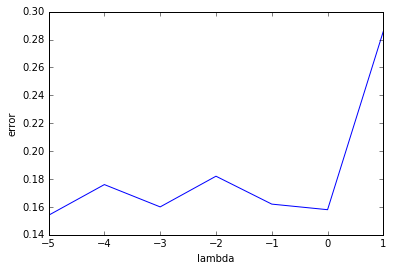

In [36]:
errors = []
for i in range(-5,2):
    Lambda = 10**i;
    w = pegasos_svm_change(X_train, y_train, Lambda=Lambda, num_iter=20)
    errors.append(percent_error(w, X_valid, y_valid))
    print(Lambda, percent_error(w, X_valid, y_valid))

plt.plot(range(-5,2), errors)
plt.xlabel("lambda")
plt.ylabel("error")
plt.savefig('/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/img66')

/Users/twff/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:20: RuntimeWarning: divide by zero encountered in double_scalars
/Users/twff/anaconda/lib/python3.5/site-packages/ipykernel/__main__.py:21: RuntimeWarning: invalid value encountered in double_scalars


The time of the 1 epoch is 0.01161651499569416
The time of the 2 epoch is 0.010885889001656324
The time of the 3 epoch is 0.011225303998799063
The time of the 4 epoch is 0.012495692004449666
The time of the 5 epoch is 0.014599881003960036
The time of the 6 epoch is 0.01302927300275769
The time of the 7 epoch is 0.012920773006044328
The time of the 8 epoch is 0.011529498995514587
The time of the 9 epoch is 0.011366797989467159
The time of the 10 epoch is 0.010354676996939816
The time of the 11 epoch is 0.010475862989551388
The time of the 12 epoch is 0.009841477003647014
The time of the 13 epoch is 0.010326190997147933
The time of the 14 epoch is 0.010062817993457429
The time of the 15 epoch is 0.013655479997396469
The time of the 16 epoch is 0.010291717000654899
The time of the 17 epoch is 0.009796814003493637
The time of the 18 epoch is 0.009862601000349969
The time of the 19 epoch is 0.009822378007811494
The time of the 20 epoch is 0.009836106008151546
nan
0.0 0.49
The time of the 1 

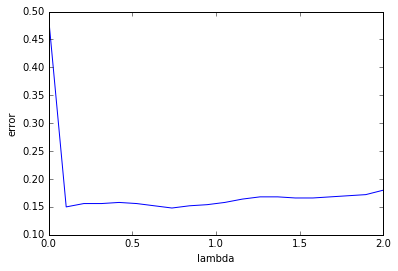

In [38]:
Lambda = np.linspace(0,2,20)
errors = []
for i in range(len(Lambda)):
    w = pegasos_svm_change(X_train, y_train, Lambda=Lambda[i], num_iter=20)
    errors.append(percent_error(w, X_valid, y_valid))
    print(Lambda[i], percent_error(w, X_valid, y_valid))

plt.plot(Lambda, errors)
plt.xlabel("lambda")
plt.ylabel("error")
plt.savefig('/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/img66b')

###  lambda = 0.1 

#### optional

In [109]:
def predict_score_group(w, X, y):
    '''
    w is the sparse weight vector
    X is the vector needed to be classified
    y is the true label
    --------------------------
    error is the percent of the wrong classifiation
    '''
    count = 0
    N = len(X)
    
    for i in range(N):
        yy = dotProduct(w, X[i])
        print(yy)  
        if yy !=y[i]:
            count +=1
    #print(count)
    error = count/N
    return error    

In [110]:
predict_score_group(w, X_valid, y_valid)

0.319666666667
0.4804
-0.0463666666667
1.33396666667
-0.572533333333
1.501
0.9381
1.2322
0.564033333333
1.38303333333
-0.0170333333333
-1.2499
0.114733333333
-0.0452333333333
0.1995
0.424766666667
0.222133333333
-0.665233333333
-0.996033333333
-0.838566666667
1.10163333333
0.176966666667
2.355
1.1395
0.2651
1.10936666667
1.05303333333
0.363133333333
0.0309
0.0677666666667
0.7649
3.20803333333
1.1169
0.842033333333
-0.898133333333
3.10636666667
0.5501
-0.8795
1.1847
1.52306666667
-0.271933333333
0.146633333333
2.72906666667
0.9397
0.2953
-0.4569
-0.2904
2.6225
0.433266666667
-0.2594
-0.598433333333
1.09803333333
0.1304
-1.0084
0.567566666667
-1.5991
-0.0867333333333
-0.312733333333
0.0541666666667
-2.19463333333
-1.65956666667
0.0424
-0.136366666667
-1.7789
1.16983333333
0.771533333333
-0.5488
1.56483333333
-1.3277
2.29303333333
-0.505833333333
1.49866666667
0.0478333333333
0.8229
0.1982
0.909333333333
0.997333333333
-1.23723333333
-0.0882333333333
-0.935666666667
-1.61416666667
1.61806

1.0

In [110]:
def list_incorrect(w, X, y):
    '''
    w is the sparse weight vector
    X is the vector needed to be classified
    y is the true label
    --------------------------
    incorrect_list is the percent of the wrong classifiation
    '''
    incorrect_list = []
    weight_list = []
    N = len(X)
    index = []
    y_p = []
    y_true = []
    wx = []
    for i in range(N):
        yy = dotProduct(w, X[i]) 
        if yy > 0:
            yy = 1
        else:
            yy = -1
        
        if yy !=y[i]:
            incorrect_list.append(X[i])
            index.append(i)
            y_p.append(yy)
            y_true.append(y[i])
            wx.append(dotProduct(w, X[i]))
            
    return incorrect_list, index, y_p, y_true,wx   

In [111]:
w = pegasos_svm_change(X_train, y_train, Lambda=10, num_iter=50)
incorrect, index, yy, yt, wx = list_incorrect(w, X_valid, y_valid)

The time of the 1 epoch is 0.36093471200729255
The time of the 2 epoch is 0.3800632070051506
The time of the 3 epoch is 0.34980500300298445
The time of the 4 epoch is 0.3510934150108369
The time of the 5 epoch is 0.35006773300119676
The time of the 6 epoch is 0.35433160699903965
The time of the 7 epoch is 0.3476005609991262
The time of the 8 epoch is 0.3579837500001304
The time of the 9 epoch is 0.34953105299791787
The time of the 10 epoch is 0.3536858480074443
The time of the 11 epoch is 0.35037964599905536
The time of the 12 epoch is 0.37427950400160626
The time of the 13 epoch is 0.3482534720096737
The time of the 14 epoch is 0.3634093220025534
The time of the 15 epoch is 0.344598550000228
The time of the 16 epoch is 0.35087431999272667
The time of the 17 epoch is 0.35113818899844773
The time of the 18 epoch is 0.3521775859990157
The time of the 19 epoch is 0.3813792479922995
The time of the 20 epoch is 0.406831714004511
The time of the 21 epoch is 0.3749771949951537
The time of the

In [72]:
percent_error(w, X_valid, y_valid)

0.286

In [100]:
w_wrong = {}
for k,v in w.items():
    if abs(v)>=0.01:
        w_wrong[k] = w.get(k, 0) + v
        
w_high = pd.DataFrame(w_wrong,index=range(len(w_wrong))).T
w_high = w_high[0]
w_high

!       -0.034757
?       -0.056659
also     0.041859
bad     -0.066707
best     0.029917
film     0.049779
great    0.029275
life     0.055275
love     0.022173
many     0.024715
movie   -0.059741
plot    -0.027611
story    0.022152
well     0.024776
world    0.028056
worst   -0.021296
Name: 0, dtype: float64

In [112]:
len(incorrect), len(yy), len(yt), len(index),len(wx)

(143, 143, 143, 143, 143)

In [129]:
w["wedding"]

0.0007999999999999962

In [113]:
import pandas as pd
summ = pd.DataFrame(index)
summ['incorr'] = incorrect
summ['y_predicted'] = yy
summ['y_true'] = yt
summ['w*x'] = wx
summ.to_csv('/Users/twff/Downloads/machine_learning/hw/hw3-sentiment/wronglist.csv')

In [88]:
Xb_train  = []
yb_train = []
bigram_list = []
i=0
j=0
while i < len(training_data)-1:
    bigram_list = []
    j= 0
    i += 1
    while j < len(training_data[i])-1:
        bigram_list.append((training_data[i][j],training_data[i][j+1]))
        j += 1
    
    words, label = bag_of_words(bigram_list)
    Xb_train.append(words)
    yb_train.append(label)
            


In [100]:
Xb_train

[Counter({('0', '4'): 1,
          ('0', 'on'): 1,
          ('0', 'to'): 1,
          ('10', 'scale'): 1,
          ('4', 'on'): 1,
          ('4', 'roger'): 1,
          ('4', 'scale'): 1,
          ('4', 'to'): 2,
          ('50sish', 'london'): 1,
          ('?', 'im'): 1,
          ('?', 'my'): 1,
          ('a', '0'): 1,
          ('a', '4'): 1,
          ('a', '50sish'): 1,
          ('a', 'bank'): 1,
          ('a', 'boulder'): 1,
          ('a', 'compact'): 1,
          ('a', 'film'): 1,
          ('a', 'great'): 1,
          ('a', 'hard'): 1,
          ('a', 'life'): 1,
          ('a', 'little'): 1,
          ('a', 'london'): 1,
          ('a', 'lot'): 1,
          ('a', 'luxurious'): 1,
          ('a', 'onetwopunch'): 1,
          ('a', "person's"): 1,
          ('a', 'rabid'): 1,
          ('a', 'really'): 1,
          ('a', 'robert'): 1,
          ('a', 'role'): 1,
          ('a', 'routine'): 1,
          ('a', 'safety'): 1,
          ('a', 'set'): 1,
          ('a', 'sort

In [87]:
def bag_of_words_bigram(words):
    '''
    words is a list of words
    -------------------
    count sparse bag of words representation.
    '''
    stop = set(stopwords.words('english'))
    words_stopfree = [w for w in words if w not in stop]
    count = Counter(words_stopfree[:-1])
    label = words[-1][1]
    return count, label

In [96]:
Xb_valid  = []
yb_valid = []
bigram_data_test = []
i=0
while i < len(validation_data)-1:
    bigram_list = []
    j= 0
    i += 1
    while j < len(validation_data[i])-1:
        bigram_list.append((validation_data[i][j],validation_data[i][j+1]))
        j += 1
    
    words, label = bag_of_words(bigram_list)
    Xb_valid.append(words)
    yb_valid.append(label)

In [103]:
n = len(Xb_valid)
w = pegasos_svm_change(Xb_train, yb_train, Lambda=0.1, num_iter=20)
error = percent_error(w, Xb_valid, yb_valid)
std_error = ((1-error)*error)/n


The time of the 1 epoch is 0.9088066149997758
The time of the 2 epoch is 1.016900076996535
The time of the 3 epoch is 1.0713688699906925
The time of the 4 epoch is 1.0566112320084358
The time of the 5 epoch is 1.2383389250026084
The time of the 6 epoch is 1.08246337500168
The time of the 7 epoch is 1.1724421160033671
The time of the 8 epoch is 1.098130341997603
The time of the 9 epoch is 1.2085885249980493
The time of the 10 epoch is 1.0928291879972676
The time of the 11 epoch is 1.1080468209984247
The time of the 12 epoch is 1.1951961659942754
The time of the 13 epoch is 1.1110157030052505
The time of the 14 epoch is 1.0253887129947543
The time of the 15 epoch is 1.0577674289961578
The time of the 16 epoch is 0.9500227170065045
The time of the 17 epoch is 0.8171304809948197
The time of the 18 epoch is 0.7503677560016513
The time of the 19 epoch is 0.7721146039984887
The time of the 20 epoch is 0.7542628579976736
3.335557038025316e-05


In [105]:
np.sqrt(std_error)

0.017852406801892162

In [106]:
error

0.19839679358717435

In [111]:
n = len(X_valid)
w = pegasos_svm_change(X_train, y_train, Lambda=0.1, num_iter=20)
error = percent_error(w, X_valid, y_valid)
std_error = ((1-error)*error)/n

The time of the 1 epoch is 0.2624861180083826
The time of the 2 epoch is 0.2455578270019032
The time of the 3 epoch is 0.23713391400815453
The time of the 4 epoch is 0.23216000199317932
The time of the 5 epoch is 0.2285955210099928
The time of the 6 epoch is 0.22674324399849866
The time of the 7 epoch is 0.2374432450014865
The time of the 8 epoch is 0.3559899329993641
The time of the 9 epoch is 0.2966216750064632
The time of the 10 epoch is 0.37707524599682074
The time of the 11 epoch is 0.27323297299153637
The time of the 12 epoch is 0.24424836100661196
The time of the 13 epoch is 0.24088752099487465
The time of the 14 epoch is 0.23444300099799875
The time of the 15 epoch is 0.2459860020026099
The time of the 16 epoch is 0.2601838190021226
The time of the 17 epoch is 0.26263246599410195
The time of the 18 epoch is 0.37210408100509085
The time of the 19 epoch is 0.23330455301038455
The time of the 20 epoch is 0.25673987199843396
3.3333333333332996e-05


In [112]:
np.sqrt(std_error)

0.015880554146502572

In [113]:
error

0.148